In [68]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
%matplotlib inline

In [69]:
#dataset link: "https://www.kaggle.com/datasets/sdolezel/black-friday"
df_train = pd.read_csv('train.csv')
df_test = pd.read_csv('test.csv')
print("Shape of train dataset is: ",df_train.shape)
print("Shape of test dataset is: ",df_test.shape)

Shape of train dataset is:  (550068, 12)
Shape of test dataset is:  (233599, 11)


In [70]:
#The dataset is in two different parts i.e. train and test so first we have to merge it in one in order to perform EDA
df = pd.concat([df_train,df_test])
df.head()

,User_ID,Product_ID,Gender,Age,Occupation,City_Category,Stay_In_Current_City_Years,Marital_Status,Product_Category_1,Product_Category_2,Product_Category_3,Purchase
0,1000001,P00069042,F,0-17,10,A,2,0,3,NaN,NaN,8370.0
1,1000001,P00248942,F,0-17,10,A,2,0,1,6.0,14.0,15200.0
2,1000001,P00087842,F,0-17,10,A,2,0,12,NaN,NaN,1422.0
3,1000001,P00085442,F,0-17,10,A,2,0,12,14.0,NaN,1057.0
4,1000002,P00285442,M,55+,16,C,4+,0,8,NaN,NaN,7969.0


In [71]:
df.shape

(783667, 12)

In [72]:
df.columns

Index(['User_ID', 'Product_ID', 'Gender', 'Age', 'Occupation', 'City_Category',
       'Stay_In_Current_City_Years', 'Marital_Status', 'Product_Category_1',
       'Product_Category_2', 'Product_Category_3', 'Purchase'],
      dtype='object')

In [73]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 783667 entries, 0 to 233598
Data columns (total 12 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   User_ID                     783667 non-null  int64  
 1   Product_ID                  783667 non-null  object 
 2   Gender                      783667 non-null  object 
 3   Age                         783667 non-null  object 
 4   Occupation                  783667 non-null  int64  
 5   City_Category               783667 non-null  object 
 6   Stay_In_Current_City_Years  783667 non-null  object 
 7   Marital_Status              783667 non-null  int64  
 8   Product_Category_1          783667 non-null  int64  
 9   Product_Category_2          537685 non-null  float64
 10  Product_Category_3          237858 non-null  float64
 11  Purchase                    550068 non-null  float64
dtypes: float64(3), int64(4), object(5)
memory usage: 77.7+ MB


In [74]:
len(df['User_ID'].unique().tolist())
#Although User_ID has a large number of unique categories still dropping this feature is not preferred.

5891

In [75]:
numerical_cols = df.select_dtypes(exclude=['object']).drop(['User_ID'],axis=1).columns.tolist()

In [76]:
# Summary statistics for numerical features
summary = df[numerical_cols].describe().T
summary['Median'] = df[numerical_cols].median()
summary['Mode'] = df[numerical_cols].mode().iloc[0]
summary['Skewness'] = df[numerical_cols].skew()
summary

,count,mean,std,min,25%,50%,75%,max,Median,Mode,Skewness
Occupation,783667.0,8.079300,6.522206,0.0,2.0,7.0,14.0,20.0,7.0,4.0,0.399767
Marital_Status,783667.0,0.409777,0.491793,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.366914
Product_Category_1,783667.0,5.366196,3.878160,1.0,1.0,5.0,8.0,20.0,5.0,5.0,0.986594
Product_Category_2,537685.0,9.844506,5.089093,2.0,5.0,9.0,15.0,18.0,9.0,8.0,-0.163941
Product_Category_3,237858.0,12.668605,4.125510,3.0,9.0,14.0,16.0,18.0,14.0,16.0,-0.766017
Purchase,550068.0,9263.968713,5023.065394,12.0,5823.0,8047.0,12054.0,23961.0,8047.0,7011.0,0.600140


In [77]:
df.isnull().sum()

,0
User_ID,0
Product_ID,0
Gender,0
Age,0
Occupation,0
City_Category,0
Stay_In_Current_City_Years,0
Marital_Status,0
Product_Category_1,0
Product_Category_2,245982


In [78]:
#Prepared a dateframe in order to plot a coutplot for the missing values
missing_values = df.isnull().sum().reset_index()
missing_values.columns = ['Feature','Count']
missing_values

,Feature,Count
0,User_ID,0
1,Product_ID,0
2,Gender,0
3,Age,0
4,Occupation,0
5,City_Category,0
6,Stay_In_Current_City_Years,0
7,Marital_Status,0
8,Product_Category_1,0
9,Product_Category_2,245982


([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11],
 [Text(0, 0, 'User_ID'),
  Text(1, 0, 'Product_ID'),
  Text(2, 0, 'Gender'),
  Text(3, 0, 'Age'),
  Text(4, 0, 'Occupation'),
  Text(5, 0, 'City_Category'),
  Text(6, 0, 'Stay_In_Current_City_Years'),
  Text(7, 0, 'Marital_Status'),
  Text(8, 0, 'Product_Category_1'),
  Text(9, 0, 'Product_Category_2'),
  Text(10, 0, 'Product_Category_3'),
  Text(11, 0, 'Purchase')])

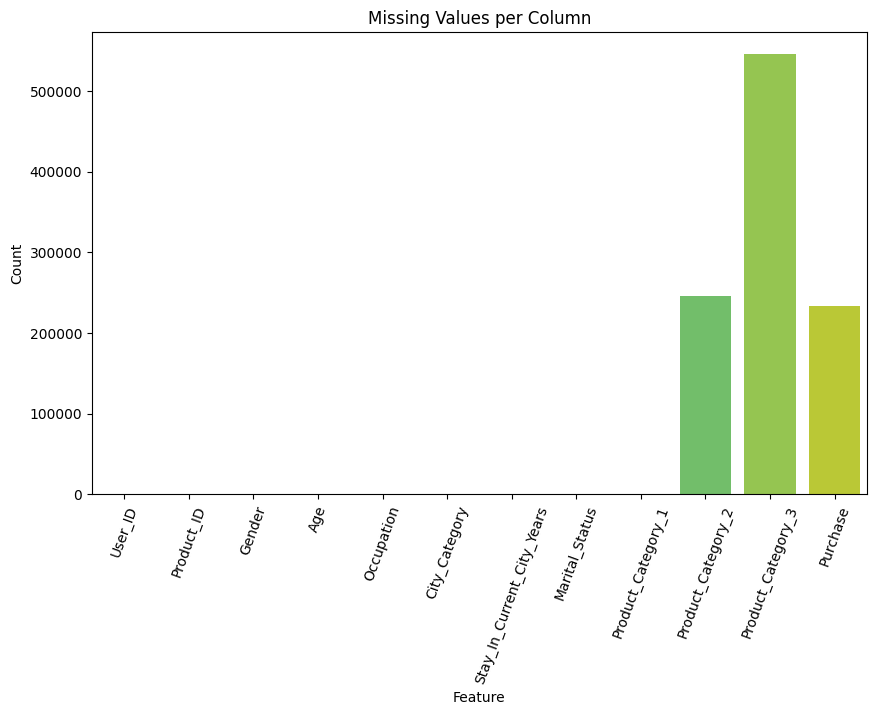

In [79]:
plt.figure(figsize=(10, 6))
sns.barplot(x='Feature', y='Count', data=missing_values, palette='viridis')
plt.title("Missing Values per Column")
plt.xticks(rotation=70)

In [80]:
df['Product_Category_2'].unique()

array([nan,  6., 14.,  2.,  8., 15., 16., 11.,  5.,  3.,  4., 12.,  9.,
       10., 17., 13.,  7., 18.])

In [81]:
df['Product_Category_3'].unique()

array([nan, 14., 17.,  5.,  4., 16., 15.,  8.,  9., 13.,  6., 12.,  3.,
       18., 11., 10.])

In [82]:
df[df['Product_ID']=='P00069042'].head(2)

,User_ID,Product_ID,Gender,Age,Occupation,City_Category,Stay_In_Current_City_Years,Marital_Status,Product_Category_1,Product_Category_2,Product_Category_3,Purchase
0,1000001,P00069042,F,0-17,10,A,2,0,3,NaN,NaN,8370.0
825,1000149,P00069042,M,26-35,1,B,2,1,3,NaN,NaN,10715.0


In [83]:
df[df['Product_ID']=='P00248942'].head(2)

,User_ID,Product_ID,Gender,Age,Occupation,City_Category,Stay_In_Current_City_Years,Marital_Status,Product_Category_1,Product_Category_2,Product_Category_3,Purchase
1,1000001,P00248942,F,0-17,10,A,2,0,1,6.0,14.0,15200.0
126,1000024,P00248942,F,26-35,7,A,3,1,1,6.0,14.0,15774.0


In [84]:
#From the above observation it can be seen that the missing values in Product_Category_2 and Product_Category_3 are because the the corresponding Product_ID does not belong to them, so they can be imputed with 0 as zero is not a valid category in both of them.
df['Product_Category_2'].fillna(0,inplace=True)
df['Product_Category_3'].fillna(0,inplace=True)

In [85]:
df.isnull().sum()

,0
User_ID,0
Product_ID,0
Gender,0
Age,0
Occupation,0
City_Category,0
Stay_In_Current_City_Years,0
Marital_Status,0
Product_Category_1,0
Product_Category_2,0


**Visualizing the data**

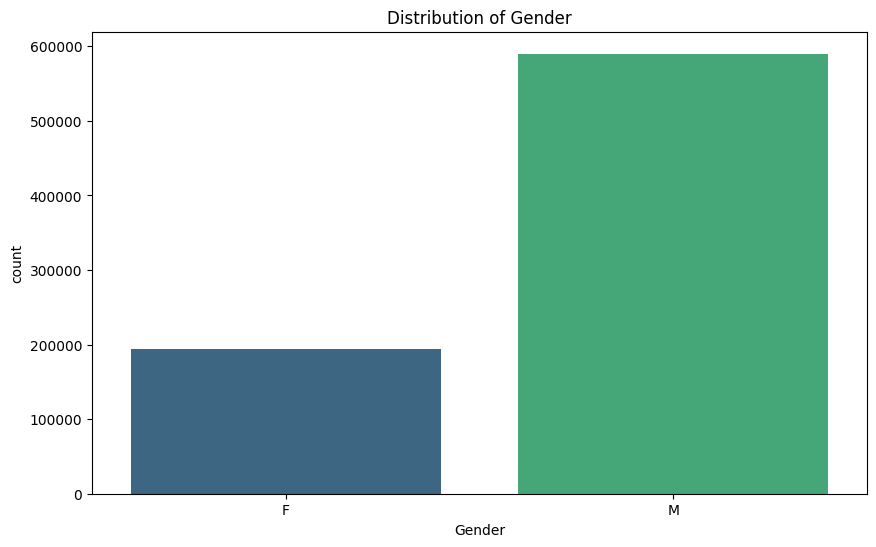

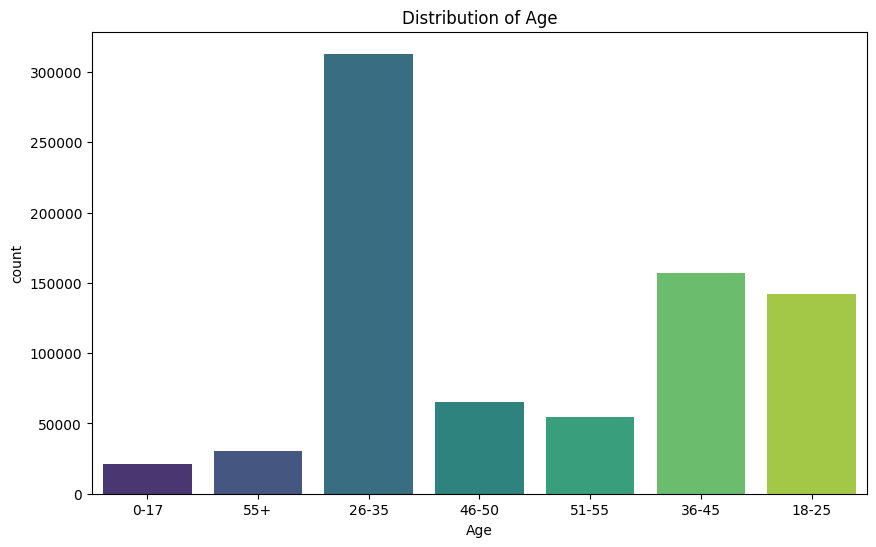

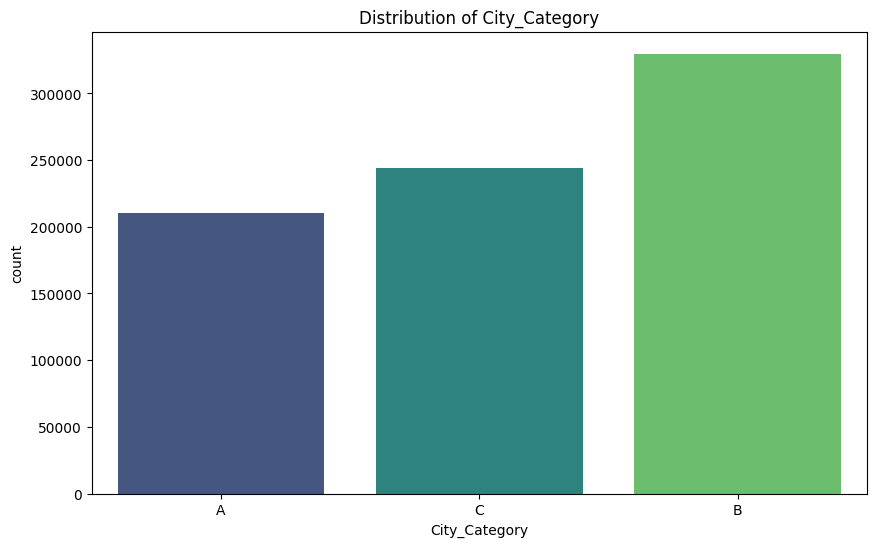

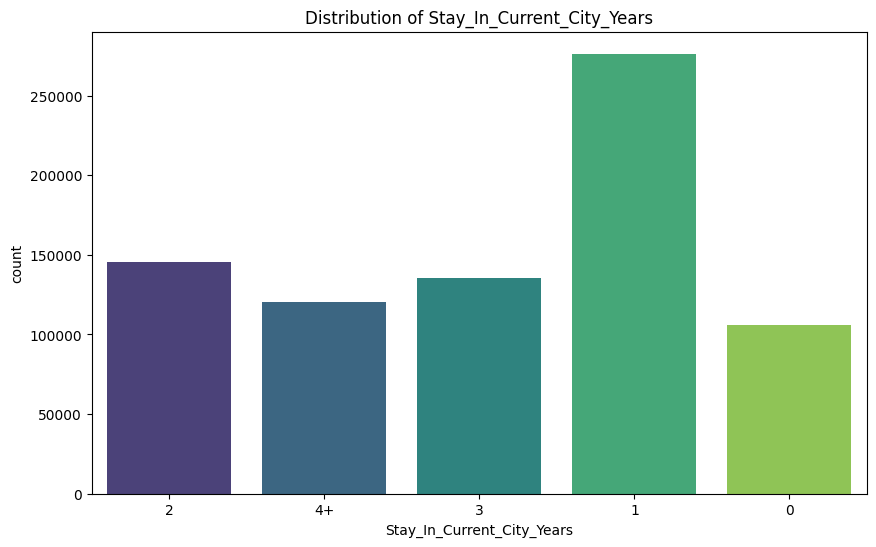

In [86]:
categorical_cols = df.select_dtypes(include=['object']).drop('Product_ID',axis=1).columns.tolist()
for col in categorical_cols:
    plt.figure(figsize=(10, 6))
    sns.countplot(x=col, data=df, palette='viridis')
    plt.title(f"Distribution of {col}")

Observation from above plots:
Considering 'Purchase' is our target feature.
*   Most of the transactions belong Male category, also the feature Gender is unbalalced.
*   Most of the transactions belong to the age range of 26-45.
*   It is also observed that person who are living in the city for 1 or 2 year has more tendency to puschase.


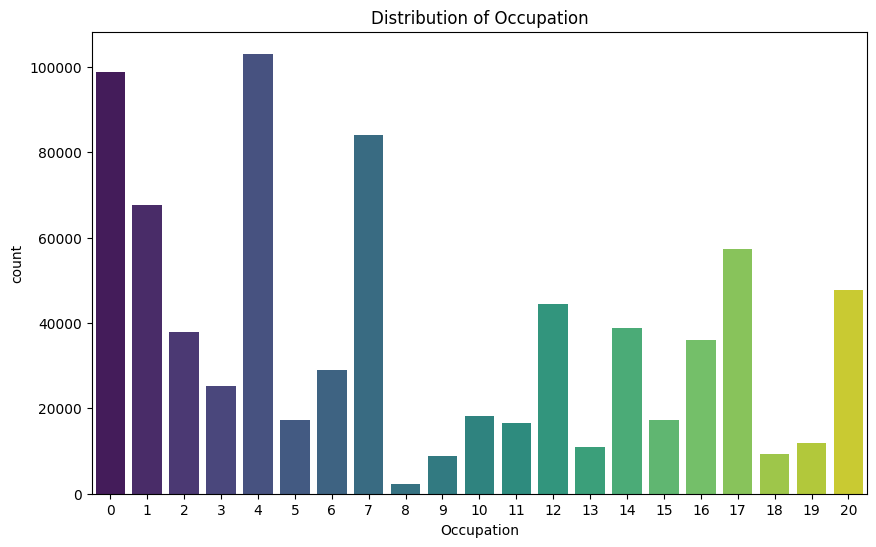

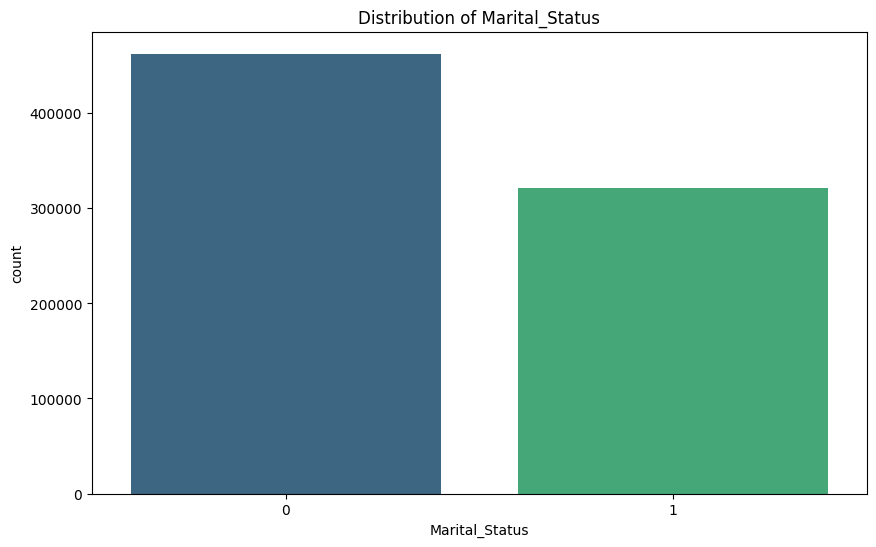

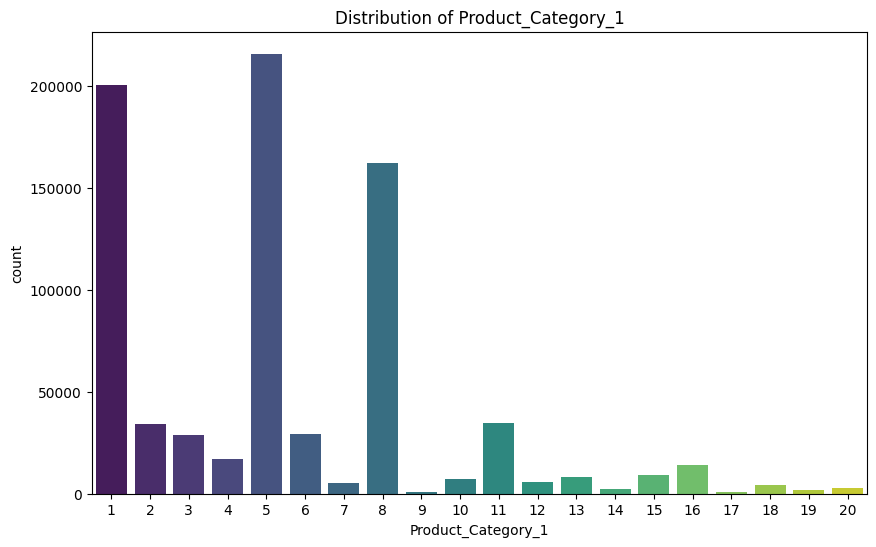

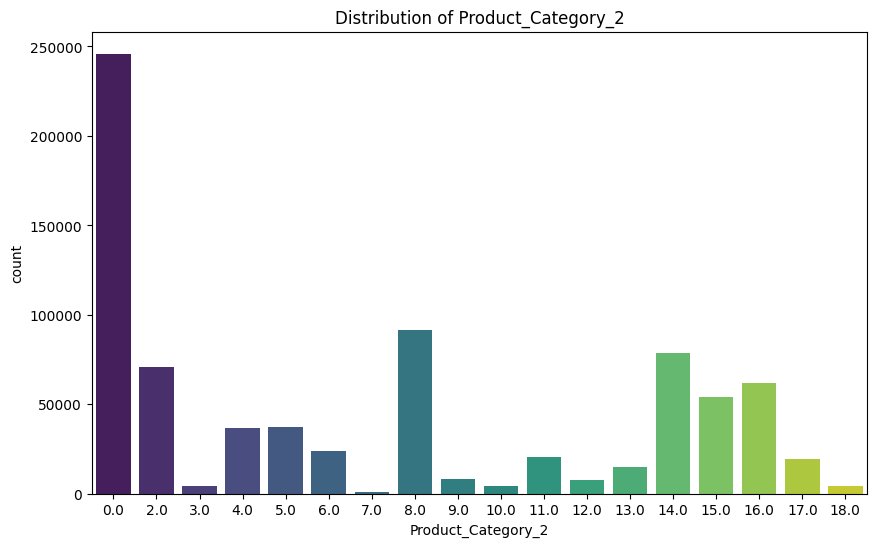

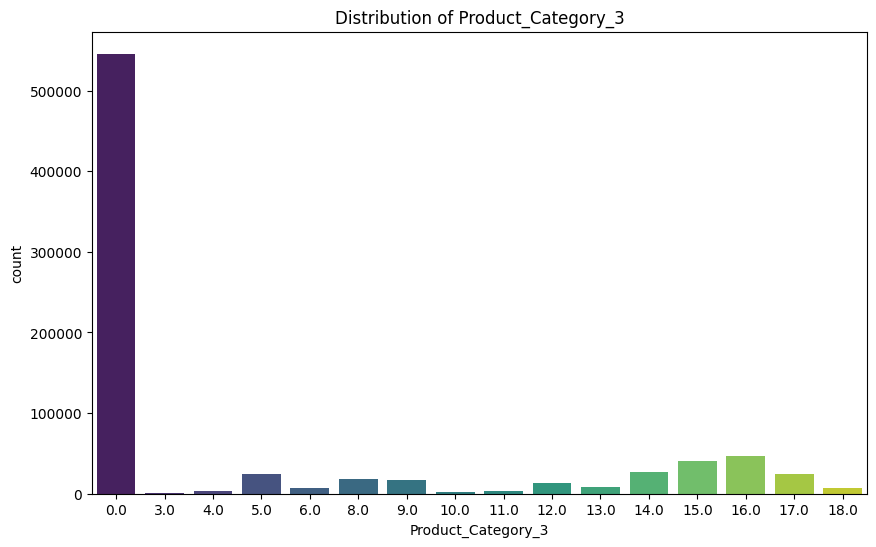

In [87]:
#Plotting countplot because these features are discrete in nature
for col in numerical_cols[:-1]:
  plt.figure(figsize=(10, 6))
  sns.countplot(x=col, data=df, palette='viridis')
  plt.title(f"Distribution of {col}")

<Axes: xlabel='Purchase', ylabel='Count'>

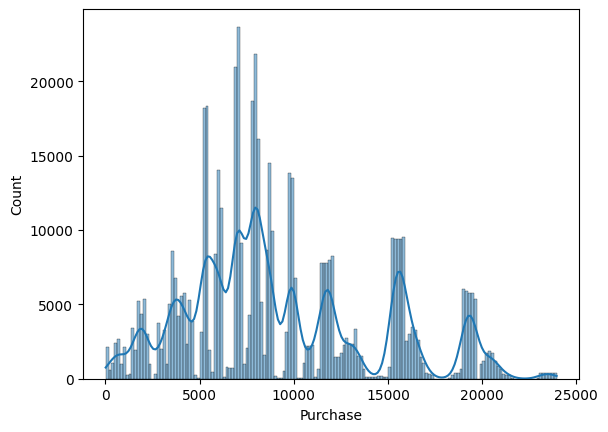

In [88]:
sns.histplot(df['Purchase'],kde=True)

In [89]:
#Plotting the same histogram using plotly
fig = px.histogram(df, x='Purchase', title='Distribution of Purchase')
fig.show()
#Observation: The distribution of Purchase is not Normal

In [90]:
#Plotting boxplots to observe outliers
for col in numerical_cols:
  fig = px.box(df, y=col, title=f'Boxplot of {col}')
  fig.show()

Observation: There are outliers in the feature Purchase, also as shown in the boxplot of Product_Category_1, category 19 and 20 are shown as outlier but they can be ignored because those categories have significant number of transaction

<Axes: ylabel='Purchase'>

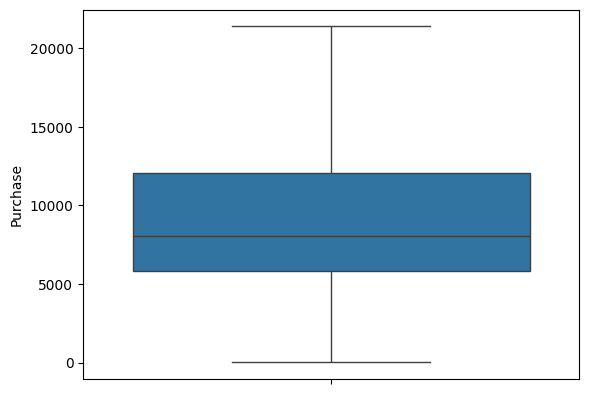

In [101]:
# Handling outliers in 'Purchase' using IQR
Q1 = df['Purchase'].quantile(0.25)
Q3 = df['Purchase'].quantile(0.75)
IQR = Q3 - Q1

lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

df['Purchase'] = np.where(df['Purchase'] < lower_bound, lower_bound, df['Purchase'])
df['Purchase'] = np.where(df['Purchase'] > upper_bound, upper_bound, df['Purchase'])
sns.boxplot(df['Purchase'])

Making a temporary dataframe and dropping the features User_ID and Product_ID from it in order to see the correlation matrix

In [91]:
df_temp = df
df_temp.drop(['User_ID','Product_ID'],axis=1,inplace=True)

Encoding the features to see correlation matrix

In [92]:
df_temp.info()

<class 'pandas.core.frame.DataFrame'>
Index: 783667 entries, 0 to 233598
Data columns (total 10 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   Gender                      783667 non-null  object 
 1   Age                         783667 non-null  object 
 2   Occupation                  783667 non-null  int64  
 3   City_Category               783667 non-null  object 
 4   Stay_In_Current_City_Years  783667 non-null  object 
 5   Marital_Status              783667 non-null  int64  
 6   Product_Category_1          783667 non-null  int64  
 7   Product_Category_2          783667 non-null  float64
 8   Product_Category_3          783667 non-null  float64
 9   Purchase                    550068 non-null  float64
dtypes: float64(3), int64(3), object(4)
memory usage: 65.8+ MB


In [93]:
#Encoding features by using map function, could also be done using LabelEncoder.
df_temp['Gender'] = df_temp['Gender'].map({'F':0,'M':1})
df_temp['Age'] = df_temp['Age'].map({'0-17':0,'18-25':1,'26-35':2,'36-45':3,'46-50':4,'51-55':5,'55+':6})
df_temp['City_Category'] = df_temp['City_Category'].map({'A':0,'B':1,'C':2})
df_temp['Stay_In_Current_City_Years'] = df_temp['Stay_In_Current_City_Years'].map({'0':0,'1':1,'2':2,'3':3,'4+':4})
df_temp.info()


<class 'pandas.core.frame.DataFrame'>
Index: 783667 entries, 0 to 233598
Data columns (total 10 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   Gender                      783667 non-null  int64  
 1   Age                         783667 non-null  int64  
 2   Occupation                  783667 non-null  int64  
 3   City_Category               783667 non-null  int64  
 4   Stay_In_Current_City_Years  783667 non-null  int64  
 5   Marital_Status              783667 non-null  int64  
 6   Product_Category_1          783667 non-null  int64  
 7   Product_Category_2          783667 non-null  float64
 8   Product_Category_3          783667 non-null  float64
 9   Purchase                    550068 non-null  float64
dtypes: float64(3), int64(7)
memory usage: 65.8 MB


In [99]:
df_temp_train = df_temp[df_temp['Purchase'].notna()]
fig = px.imshow(df_temp_train.corr(), text_auto=True, color_continuous_scale='RdBu_r',title='Correlation Matrix')
fig.update_layout(width=900, height=900)
fig.show()

1️⃣ Dataset Overview

*   The dataset contains customer transactions from a Black Friday sale event.
*   Key features include demographics (Gender, Age, City_Category), duration of city stay, product categories, and purchase amounts.



---



2️⃣ Key Findings from Descriptive Statistics


*   The dataset has missing values in Product_Category_2 and Product_Category_3.
*   Most transactions are made by male customers, indicating an imbalance in the gender distribution.
*   The majority of customers fall in the 26-45 years age group.
*   Customers with 1-2 years of city stay are more likely to purchase, suggesting recent movers may show higher purchase activity.



---


3️⃣ Visual Analysis Highlights

*   Histograms & Boxplots:
    *   'Purchase' shows outliers on the higher end of values.
    *   Product categories 19 and 20 appear as outliers in Product_Category_1, but they are valid due to their significant frequency.
*   City Category Distribution:
    *   City Category B has the highest transaction count, followed by C and A.



---


4️⃣ Correlation Insights


*   Overall, weak linear correlations exist between most features and Purchase.
*   Product_Category_1 has the most notable (still weak) positive correlation with Purchase.
*   Product_Category_1, Product_Category_2, and Product_Category_3 are moderately correlated among themselves, which is expected as they represent related product groupings.
*   Product_Category_1, Product_Category_2, and Product_Category_3 are moderately correlated among themselves, which is expected as they represent related product groupings







---


5️⃣ Final Inferences


*   The dataset exhibits demographic trends in gender and age affecting purchase patterns.
*   Weak correlations suggest linear models may have limited effectiveness; exploring non-linear models or feature engineering is recommended.
*   Outliers should be carefully handled based on modeling requirements, especially for 'Purchase'.
*   The data is ready for further feature engineering and predictive modeling after addressing missing values and outliers as per business needs.
